#Libraries and Dependencies

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
# Download the data from my Gdrive
!gdown --id 1DsZoUS2sqp0PhvLr8VRma-vERZQjp60r

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1DsZoUS2sqp0PhvLr8VRma-vERZQjp60r
To: /content/lung.png
100% 3.69M/3.69M [00:00<00:00, 38.4MB/s]


# **1C** Open it with Matlab/Python and display it in a window using (for example) the “imshow” function



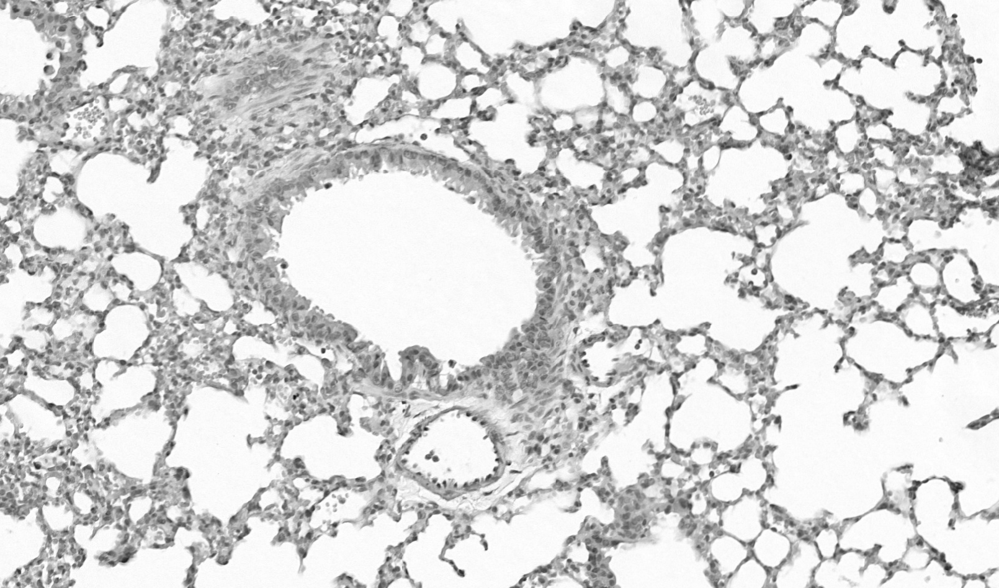

In [ ]:
# Setting the image name and path
file_name = "lung.png"

# Loading the image using OpenCV
img = cv.imread(file_name, 0)

# converting the image to numpy array for better access to the row
image_array = np.array(img)

# Displaying the image ( Note only runs in Google Colab, in local system use cv.imshow("Gray Scale", img))
cv2_imshow(img)

# **1D** Display the image’s histogram.

(array([3.10000e+01, 1.07900e+03, 9.96500e+03, 3.88060e+04, 8.18940e+04,
        1.38507e+05, 1.78863e+05, 1.53021e+05, 1.26125e+05, 7.97989e+05]),
 array([ 13. ,  37.2,  61.4,  85.6, 109.8, 134. , 158.2, 182.4, 206.6,
        230.8, 255. ]),
 <BarContainer object of 10 artists>)

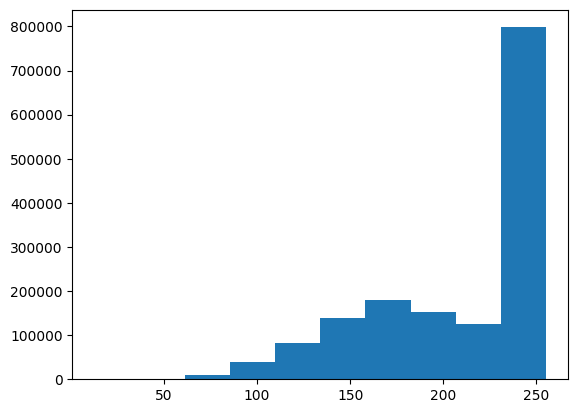

In [ ]:
plt.hist(image_array.flatten())

# **1E** Choose an interesting row or a column of the image (i.e. containing homogeneous and inhomogeneous areas, soft and sharp edges), and display it in a window using the “plot” function

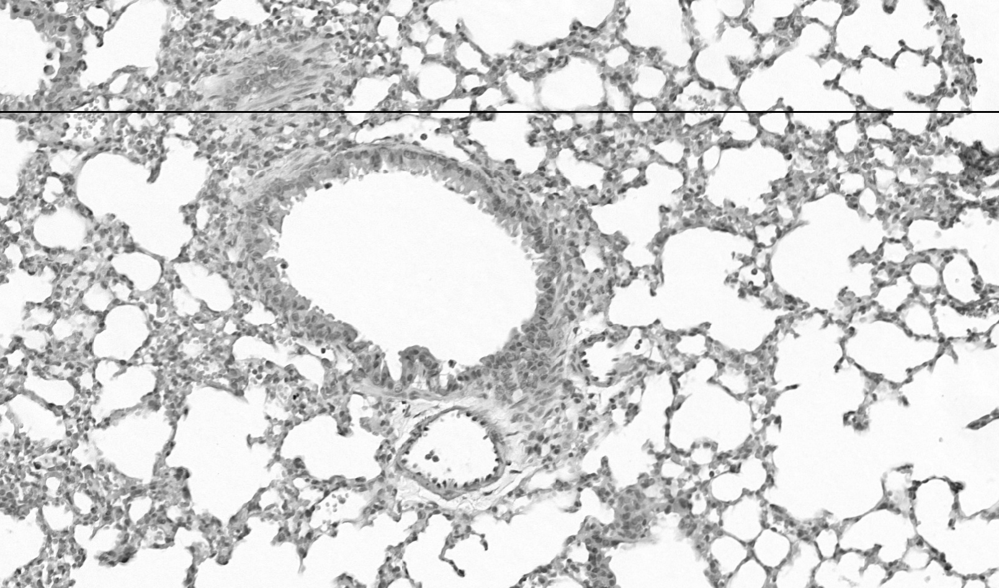

(array([  5.,  21.,  43.,  60.,  98., 248., 279., 199., 154., 503.]),
 array([ 48. ,  68.6,  89.2, 109.8, 130.4, 151. , 171.6, 192.2, 212.8,
        233.4, 254. ]),
 <BarContainer object of 10 artists>)

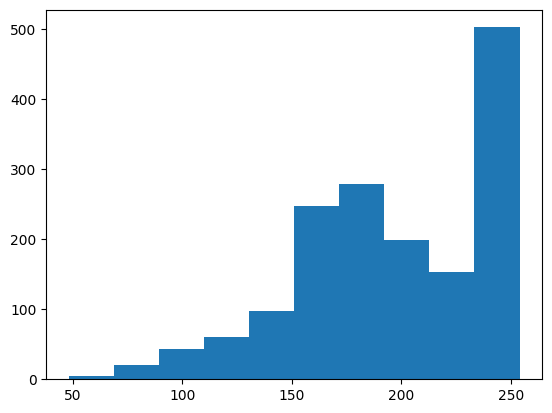

In [ ]:
# Select the row of interest (Compared to other parts, it is more darker with more detailed objects)
y = 180
start_point = (0, y)
end_point = (img.shape[1] - 1, y)

img_line = img.copy()
# Draw a line on the selected row
cv.line(img_line, start_point, end_point, color=(0, 255, 0), thickness=2)

# Show the image with the drawn line
cv2_imshow(img_line)
cv.waitKey(0)
cv.destroyAllWindows()

# Extract the pixel values along the selected row (row 180)
plt.hist(image_array[y,:])

Compared to the original histogram, we can see more darker area in hostogram as well

# **1F** How many modes does the histogram have? Can you identify each mode with specific structures in the image? Explain.


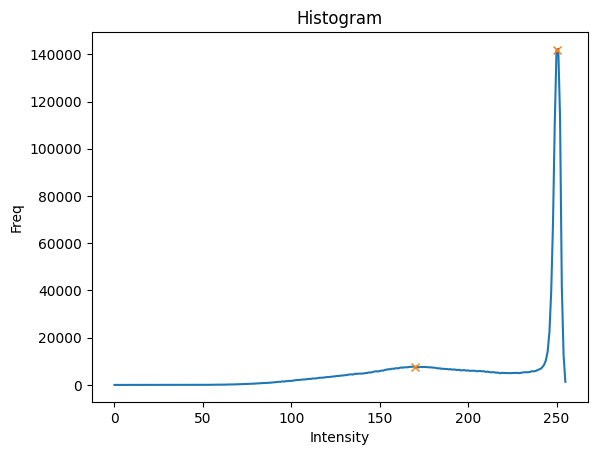

In [ ]:
# Plot the histogram
hist, bins = np.histogram(image_array.flatten(), bins=256, range=(0, 256))

# Plotting the histogram
plt.plot(hist)
plt.title('Histogram')
plt.xlabel('Intensity')
plt.ylabel('Freq')


# Mark the peaks on the histogram, I found the index by eyes
plt.plot([250,170], hist[[250,170]], "x")
plt.show()

https://docs.opencv.org/3.4/d3/dc1/tutorial_basic_linear_transform.html#:~:text=lookUpTable%20%3D%20np.empty,(img_original%2C%20lookUpTable)

# **1G** Try three different levels of gamma correction. Show the resulting images and the code to generate them.

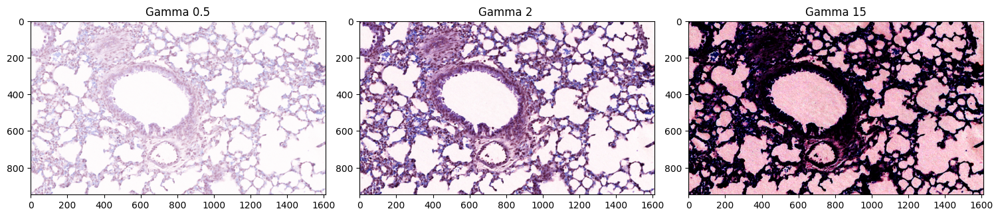

In [ ]:
def apply_gamma_correction(img, gamma):
  lookUpTable = np.empty((1,256), np.uint8)
  for i in range(256):
      lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)
  return cv.LUT(img, lookUpTable)

img = cv.imread(file_name)
img_gamma_05 = apply_gamma_correction(img, gamma=0.5)
img_gamma_2 = apply_gamma_correction(img, gamma=2)
img_gamma_15 = apply_gamma_correction(img, gamma=15)


plt.figure(figsize=(15, 5))


plt.subplot(1, 3, 1)
plt.imshow(img_gamma_05,cmap='jet')
plt.title("Gamma 0.5")

plt.subplot(1, 3, 2)
plt.imshow(img_gamma_2,cmap='jet')
plt.title("Gamma 2 ")

plt.subplot(1, 3, 3)
plt.imshow(img_gamma_15,cmap='jet')
plt.title("Gamma 15")

plt.tight_layout()
plt.show()


img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# **1H** Which level of gamma correction do you consider best? Why? What does this say about the underlying imaging technology

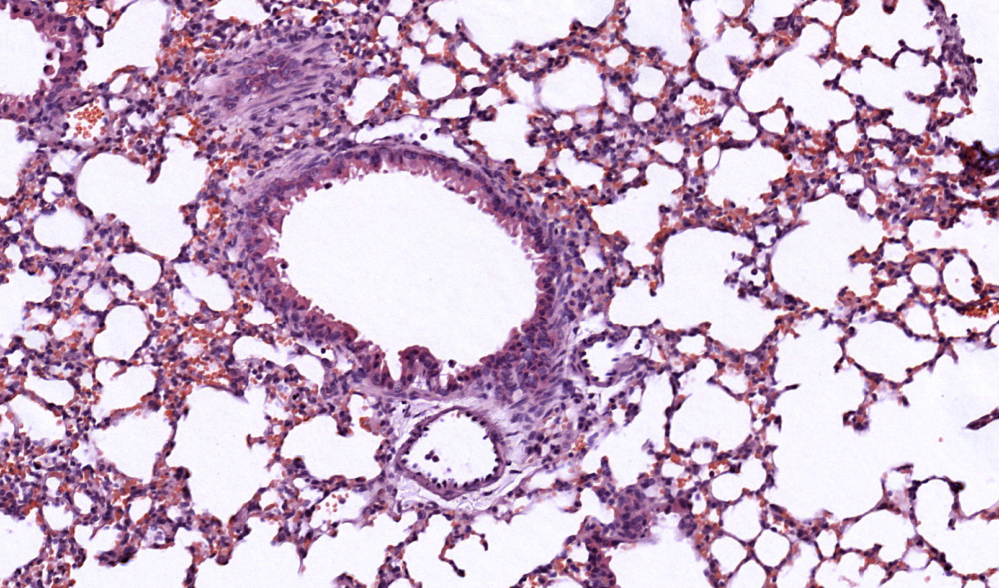

True

In [ ]:
cv2_imshow(img_gamma_2)
cv.imwrite("img_gamma_2.png", img_gamma_2)

# **2A** Select an “interesting” 50×50 pixel region of the image from Section 1. It should contain contrasts and edges and include the row from 1E.. Show the region



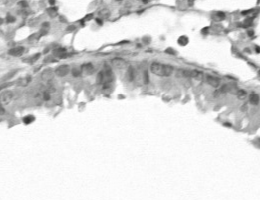

In [ ]:
img_200x200 = image_array[180:380,500:760]
cv2_imshow(img_200x200)

# **2B** Apply a 3x3 averaging filter to the original image. Display the filtered image.



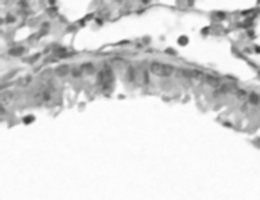

In [ ]:
kernel = np.ones((3,3),np.float32)/9
avg_img = cv.filter2D(img_200x200,-1,kernel)
cv2_imshow(avg_img)

# **2C** Extract the same row or column as you did before from the original image, and display it using the “hold” and “plot” functions on the same graph as the original row or column but with a distinct colour.

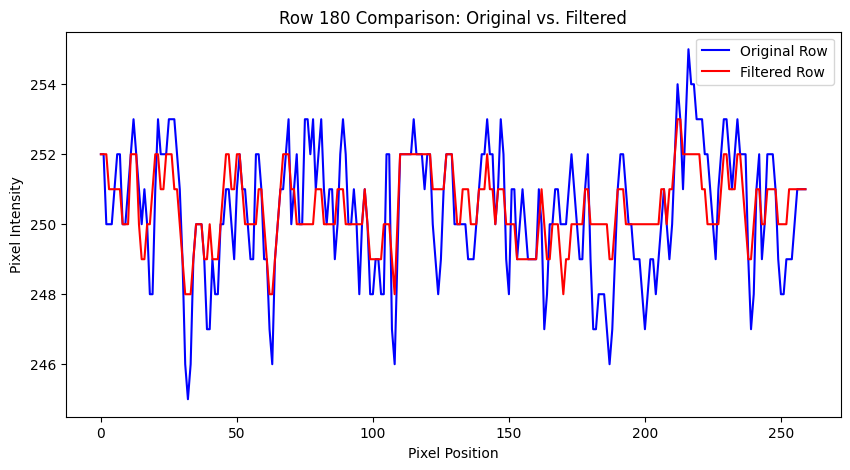

In [ ]:
original_row = img_200x200[y, :]
filtered_row = avg_img[y, :]

plt.figure(figsize=(10, 5))

plt.plot(original_row, label='Original Row', color='blue')

plt.plot(filtered_row, label='Filtered Row', color='red')

plt.title(f'Row {y} Comparison: Original vs. Filtered')
plt.xlabel('Pixel Position')
plt.ylabel('Pixel Intensity')
plt.legend()

plt.show()

# **2D** Apply a 3x3 median filter to the original image. Display the filtered image.



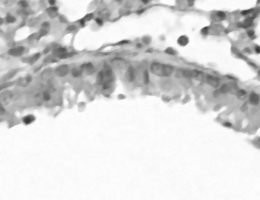

In [ ]:
med_img = cv.medianBlur(img_200x200,3)
cv2_imshow(med_img)

# **2E** Extract the same row or column as you did before from the original and averaged images, and display it using the “hold” and “plot” functions on the same graph as the original row or column but with a distinct colour.

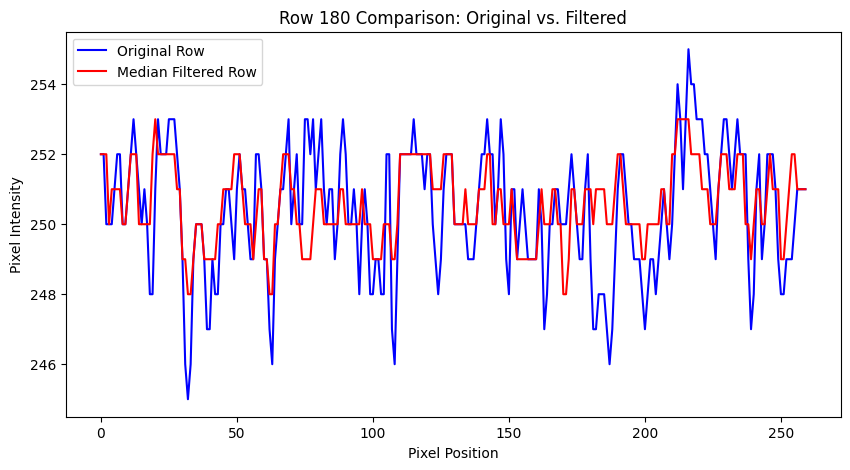

In [ ]:
med_filtered_row = med_img[y, :]

plt.figure(figsize=(10, 5))

plt.plot(original_row, label='Original Row', color='blue')

plt.plot(med_filtered_row, label='Median Filtered Row', color='red')

plt.title(f'Row {y} Comparison: Original vs. Filtered')
plt.xlabel('Pixel Position')
plt.ylabel('Pixel Intensity')
plt.legend()

plt.show()

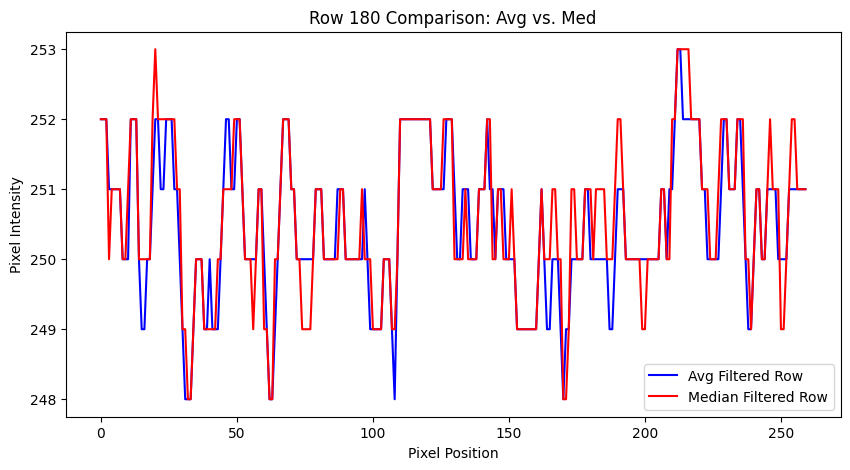

In [ ]:


plt.figure(figsize=(10, 5))

plt.plot(filtered_row, label='Avg Filtered Row', color='blue')

plt.plot(med_filtered_row, label='Median Filtered Row', color='red')

plt.title(f'Row {y} Comparison: Avg vs. Med')
plt.xlabel('Pixel Position')
plt.ylabel('Pixel Intensity')
plt.legend()

plt.show()

# **3A** Use the Matlab command “imnoise” to generate two noisy versions of the image, one with salt and pepper noise and the other with Gaussian white noise.


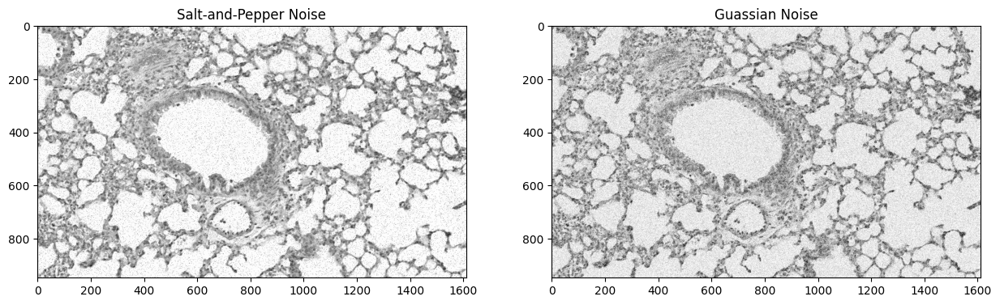

In [ ]:
from skimage import util

# Add salt-and-pepper noise
salt_pepper_noise_img = util.random_noise(img, mode='s&p', amount=0.05)

salt_pepper_noise_img_uint8 = (salt_pepper_noise_img * 255).astype(np.uint8)

# Add gaussian noise
gaussian_noise_img = util.random_noise(img, mode='gaussian', var=0.05)
gaussian_noise_img_uint8 = (gaussian_noise_img * 255).astype(np.uint8)

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.imshow(salt_pepper_noise_img_uint8, cmap='gray')
plt.title("Salt-and-Pepper Noise")

plt.subplot(1, 2, 2)
plt.imshow(gaussian_noise_img_uint8, cmap='gray')
plt.title("Guassian Noise")

plt.show()

# **3B** Apply a 5×5 Gaussian and median filter using the same mask size to the noisy images.

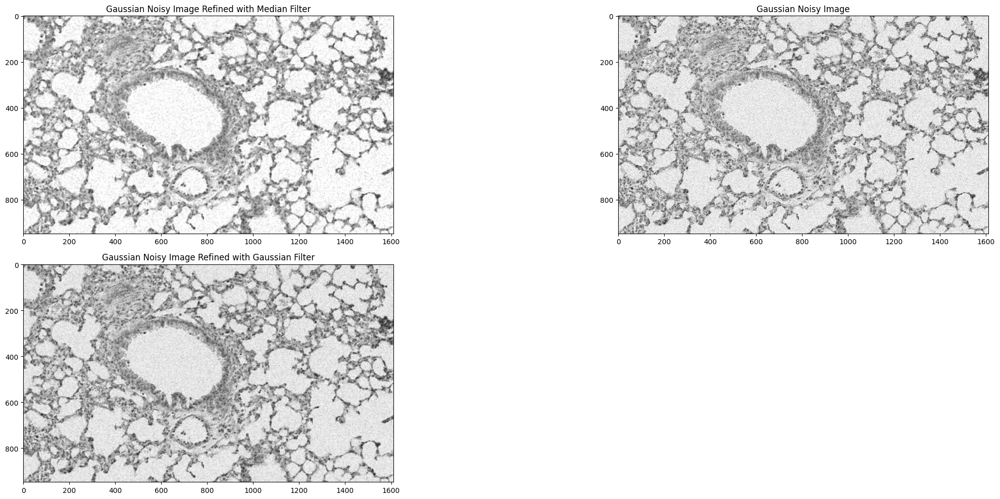

In [ ]:
guas_noise_med_ref = cv.medianBlur(gaussian_noise_img_uint8,5)

guas_noise_guas_ref = cv.GaussianBlur(np.array(gaussian_noise_img_uint8),(5,5),0)

plt.figure(figsize=(25, 10))

# Gaussian Noisy image
plt.subplot(2, 2, 2)
plt.imshow(gaussian_noise_img_uint8, cmap='gray')
plt.title("Gaussian Noisy Image")

# Gaussian Noisy Image refined with Median Filter
plt.subplot(2, 2, 1)
plt.imshow(guas_noise_med_ref, cmap='gray')
plt.title("Gaussian Noisy Image Refined with Median Filter")

# Gaussian Noisy Image Refined with Gaussian Filter
plt.subplot(2, 2, 3)
plt.imshow(guas_noise_guas_ref, cmap='gray')
plt.title("Gaussian Noisy Image Refined with Gaussian Filter")


# Show the plots
plt.tight_layout()
plt.show()

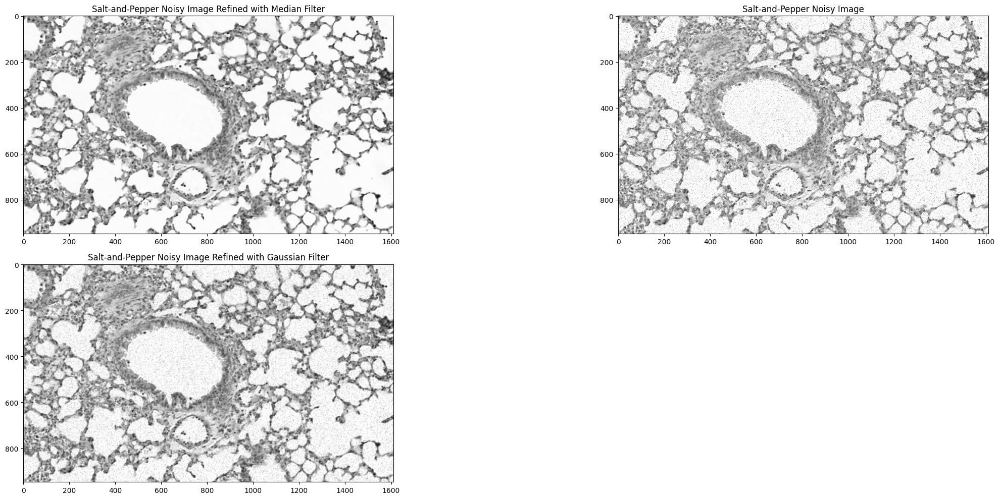

In [ ]:
sp_noise_med_ref = cv.medianBlur(salt_pepper_noise_img_uint8,5)

sp_noise_guas_ref = cv.GaussianBlur(np.array(salt_pepper_noise_img_uint8),(5,5),0)

plt.figure(figsize=(25, 10))

# Salt-and-Pepper Noisy Image
plt.subplot(2, 2, 2)
plt.imshow(salt_pepper_noise_img_uint8, cmap='gray')
plt.title("Salt-and-Pepper Noisy Image")

# Salt-and-Pepper Noisy Image refined with Median Filter
plt.subplot(2, 2, 1)
plt.imshow(sp_noise_med_ref, cmap='gray')
plt.title("Salt-and-Pepper Noisy Image Refined with Median Filter")

# Salt-and-Pepper Noisy Image Refined with Gaussian Filter
plt.subplot(2, 2, 3)
plt.imshow(sp_noise_guas_ref, cmap='gray')
plt.title("Salt-and-Pepper Noisy Image Refined with Gaussian Filter")


# Show the plots
plt.tight_layout()
plt.show()

# **3C:** Compare the performance of the filters and windows sizes in terms of: mean squared error and general visual properties.

Window Size: 3
  MSE for Median Filter on Salt-and-Pepper Noise: 10.16
  MSE for Gaussian Filter on Salt-and-Pepper Noise: 32.92
  MSE for Median Filter on Gaussian Noise: 56.54
  MSE for Gaussian Filter on Gaussian Noise: 65.27
Window Size: 5
  MSE for Median Filter on Salt-and-Pepper Noise: 24.94
  MSE for Gaussian Filter on Salt-and-Pepper Noise: 44.04
  MSE for Median Filter on Gaussian Noise: 50.27
  MSE for Gaussian Filter on Gaussian Noise: 66.25
Window Size: 7
  MSE for Median Filter on Salt-and-Pepper Noise: 35.51
  MSE for Gaussian Filter on Salt-and-Pepper Noise: 57.44
  MSE for Median Filter on Gaussian Noise: 52.37
  MSE for Gaussian Filter on Gaussian Noise: 71.71
Window Size: 9
  MSE for Median Filter on Salt-and-Pepper Noise: 42.10
  MSE for Gaussian Filter on Salt-and-Pepper Noise: 63.55
  MSE for Median Filter on Gaussian Noise: 55.75
  MSE for Gaussian Filter on Gaussian Noise: 76.01


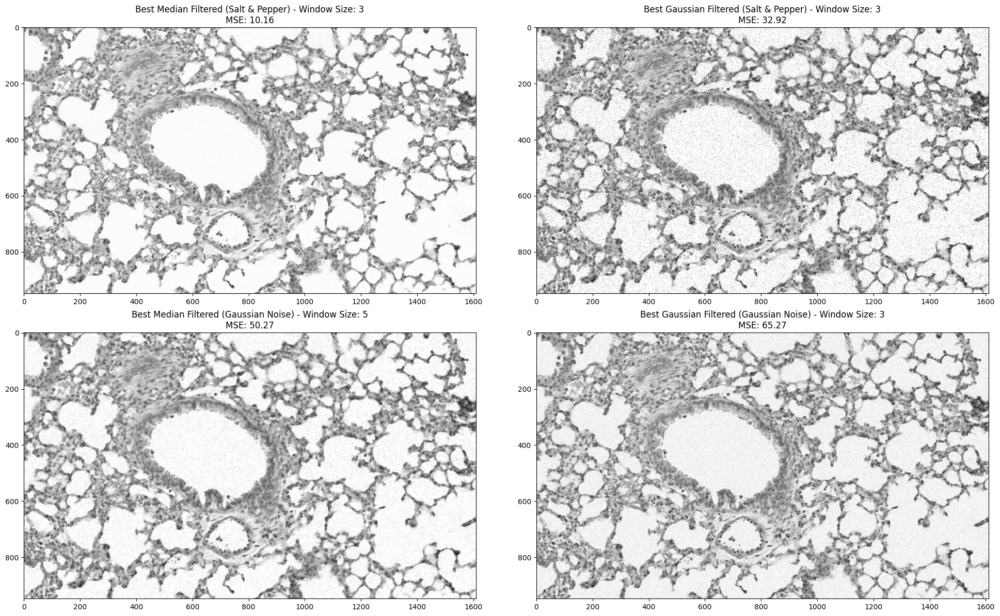

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from skimage import util
from sklearn.metrics import mean_squared_error



# Add salt-and-pepper noise
salt_pepper_noise_img = util.random_noise(img, mode='s&p', amount=0.05)
salt_pepper_noise_img_uint8 = (salt_pepper_noise_img * 255).astype(np.uint8)

# Add Gaussian noise
gaussian_noise_img = util.random_noise(img, mode='gaussian', var=0.01)
gaussian_noise_img_uint8 = (gaussian_noise_img * 255).astype(np.uint8)

# Define filter window sizes
window_sizes = [3, 5, 7, 9]
results = {}

for window_size in window_sizes:

    # Apply Median Filter to Salt-and-Pepper Noise
    med_sp_filtered = cv.medianBlur(salt_pepper_noise_img_uint8, window_size)
    mse_med_sp = mean_squared_error(img, med_sp_filtered)

    # Apply Gaussian Filter to Salt-and-Pepper Noise
    gaus_sp_filtered = cv.GaussianBlur(salt_pepper_noise_img_uint8, (window_size, window_size),0)
    mse_gaus_sp = mean_squared_error(img, gaus_sp_filtered)

    # Apply Median Filter to Gaussian Noise
    med_gaus_filtered = cv.medianBlur(gaussian_noise_img_uint8, window_size)
    mse_med_gaus = mean_squared_error(img, med_gaus_filtered)

    # Apply Gaussian Filter to Gaussian Noise
    gaus_gaus_filtered = cv.GaussianBlur(gaussian_noise_img_uint8, (window_size, window_size), 0)
    mse_gaus_gaus = mean_squared_error(img, gaus_gaus_filtered)


    results[window_size] = {
        "MSE_med_sp": mse_med_sp,
        "MSE_gaus_sp": mse_gaus_sp,
        "MSE_med_gaus": mse_med_gaus,
        "MSE_gaus_gaus": mse_gaus_gaus,
        "med_sp_filtered": med_sp_filtered,
        "gaus_sp_filtered": gaus_sp_filtered,
        "med_gaus_filtered": med_gaus_filtered,
        "gaus_gaus_filtered": gaus_gaus_filtered,
    }


for size, mse_values in results.items():

    print(f"Window Size: {size}")
    print(f"  MSE for Median Filter on Salt-and-Pepper Noise: {mse_values['MSE_med_sp']:.2f}")
    print(f"  MSE for Gaussian Filter on Salt-and-Pepper Noise: {mse_values['MSE_gaus_sp']:.2f}")
    print(f"  MSE for Median Filter on Gaussian Noise: {mse_values['MSE_med_gaus']:.2f}")
    print(f"  MSE for Gaussian Filter on Gaussian Noise: {mse_values['MSE_gaus_gaus']:.2f}")

# Find the best results based on MSE
best_med_sp = min(results, key=lambda x: results[x]["MSE_med_sp"])
best_gaus_sp = min(results, key=lambda x: results[x]["MSE_gaus_sp"])
best_med_gaus = min(results, key=lambda x: results[x]["MSE_med_gaus"])
best_gaus_gaus = min(results, key=lambda x: results[x]["MSE_gaus_gaus"])

plt.figure(figsize=(20, 12))

plt.subplot(2, 2, 1)
plt.imshow(results[best_med_sp]["med_sp_filtered"], cmap='gray')
plt.title(f"Best Median Filtered (Salt & Pepper) - Window Size: {best_med_sp}\nMSE: {results[best_med_sp]['MSE_med_sp']:.2f}")

plt.subplot(2, 2, 2)
plt.imshow(results[best_gaus_sp]["gaus_sp_filtered"], cmap='gray')
plt.title(f"Best Gaussian Filtered (Salt & Pepper) - Window Size: {best_gaus_sp}\nMSE: {results[best_gaus_sp]['MSE_gaus_sp']:.2f}")

plt.subplot(2, 2, 3)
plt.imshow(results[best_med_gaus]["med_gaus_filtered"], cmap='gray')
plt.title(f"Best Median Filtered (Gaussian Noise) - Window Size: {best_med_gaus}\nMSE: {results[best_med_gaus]['MSE_med_gaus']:.2f}")

plt.subplot(2, 2, 4)
plt.imshow(results[best_gaus_gaus]["gaus_gaus_filtered"], cmap='gray')
plt.title(f"Best Gaussian Filtered (Gaussian Noise) - Window Size: {best_gaus_gaus}\nMSE: {results[best_gaus_gaus]['MSE_gaus_gaus']:.2f}")

plt.tight_layout()
plt.show()


# **4A** Show the 3×3 convolution kernels for: i) Prewitt, ii) Sobel, ii) Gaussian, iii) Laplace filters

# **4B** Apply each filter to the image. Show the image and a line through the image.


In [ ]:
prewitt_kernel_x = np.array([[1, 0, -1],
                             [1, 0, -1],
                             [1, 0, -1]])

prewitt_kernel_y = np.array([[1, 1, 1],
                             [0, 0, 0],
                             [-1, -1, -1]])

sobel_kernel_x = np.array([[1, 0, -1],
                           [2, 0, -2],
                           [1, 0, -1]])

sobel_kernel_y = np.array([[1, 2, 1],
                           [0, 0, 0],
                           [-1, -2, -1]])

gaussian_kernel = cv.getGaussianKernel(3, 0)
gaussian_kernel = gaussian_kernel * gaussian_kernel.T

laplace_kernel = np.array([[0, -1, 0],
                           [-1, 4, -1],
                           [0, -1, 0]])

# Apply the filters
prewitt_x = cv.filter2D(img, -1, prewitt_kernel_x)
prewitt_y = cv.filter2D(img, -1, prewitt_kernel_y)
sobel_x = cv.filter2D(img, -1, sobel_kernel_x)
sobel_y = cv.filter2D(img, -1, sobel_kernel_y)
gaussian = cv.filter2D(img, -1, gaussian_kernel)
laplace = cv.filter2D(img, -1, laplace_kernel)

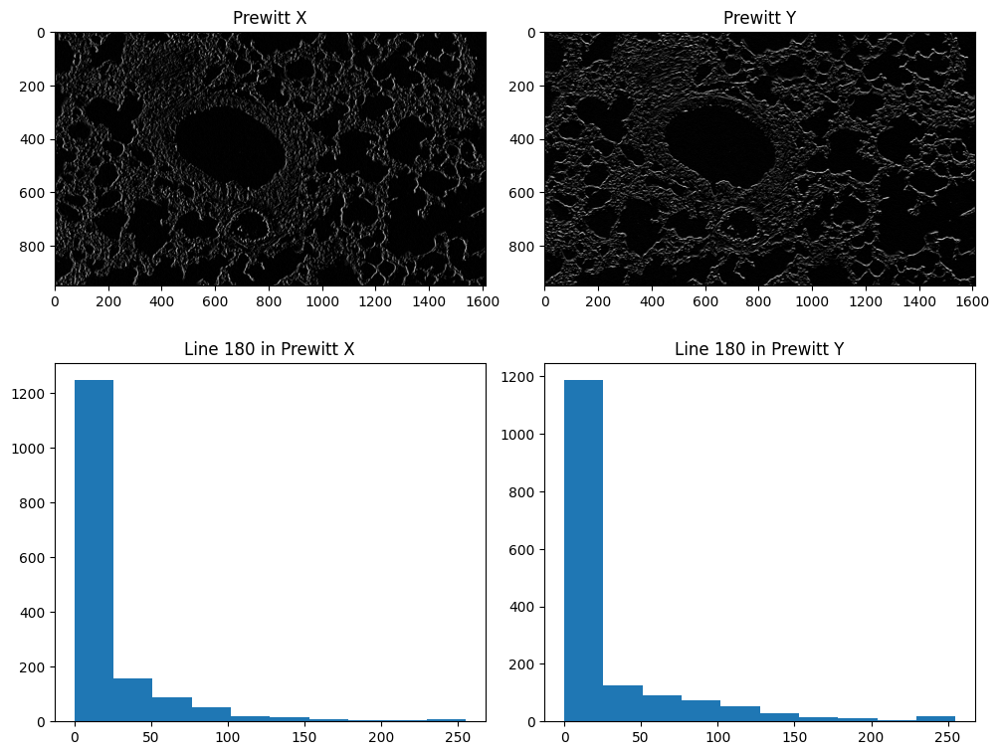

In [ ]:
plt.figure(figsize=(10, 8))

plt.subplot(221), plt.imshow(prewitt_x, cmap='gray'), plt.title('Prewitt X')
plt.subplot(222), plt.imshow(prewitt_y, cmap='gray'), plt.title('Prewitt Y')
plt.subplot(223), plt.hist(prewitt_x[180,:]), plt.title('Line 180 in Prewitt X')
plt.subplot(224), plt.hist(prewitt_y[180,:]), plt.title('Line 180 in Prewitt Y')

plt.tight_layout()
plt.show()

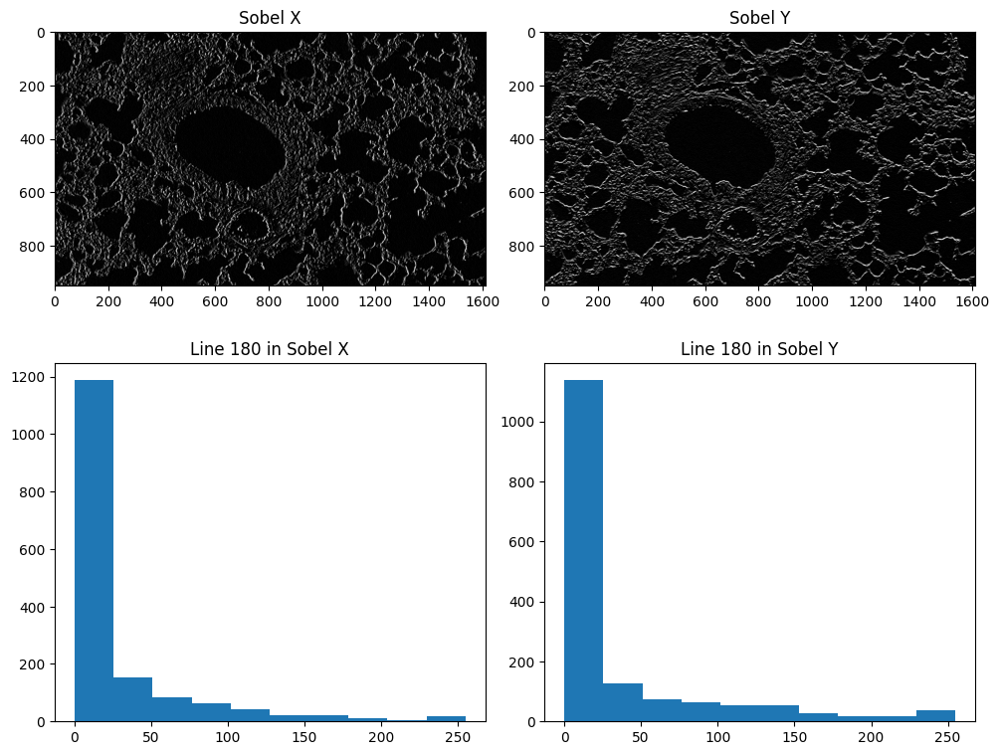

In [ ]:
plt.figure(figsize=(10, 8))

plt.subplot(221), plt.imshow(sobel_x, cmap='gray'), plt.title('Sobel X')
plt.subplot(222), plt.imshow(sobel_y, cmap='gray'), plt.title('Sobel Y')
plt.subplot(223), plt.hist(sobel_x[180,:]), plt.title('Line 180 in Sobel X')
plt.subplot(224), plt.hist(sobel_y[180,:]), plt.title('Line 180 in Sobel Y')

plt.tight_layout()
plt.show()

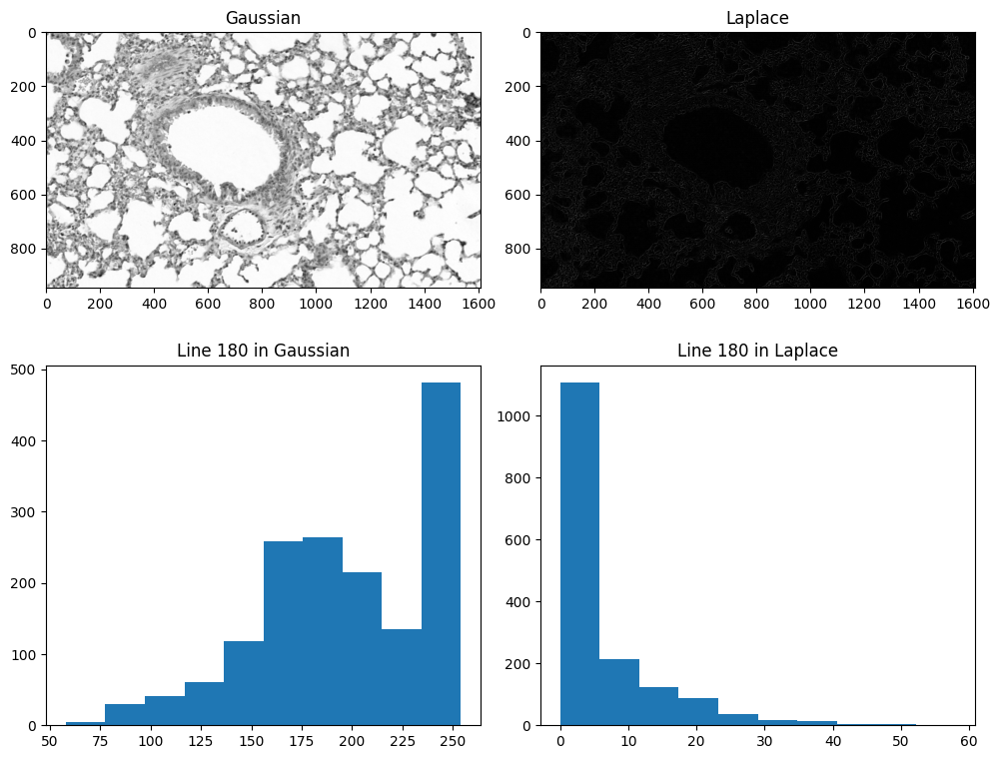

In [ ]:
plt.figure(figsize=(10, 8))

plt.subplot(221), plt.imshow(gaussian, cmap='gray'), plt.title('Gaussian')
plt.subplot(222), plt.imshow(laplace, cmap='gray'), plt.title('Laplace')
plt.subplot(223), plt.hist(gaussian[180,:]), plt.title('Line 180 in Gaussian')
plt.subplot(224), plt.hist(laplace[180,:]), plt.title('Line 180 in Laplace')

plt.tight_layout()
plt.show()

# **4C** Calculate a 7×7 Laplacian of Gaussian kernel (LoG) (you chose the parameters)

# **4D** Apply the  filter to the image for three different parameter values. Show the image and a line through the image.





$$\operatorname{LoG}(\mathrm{x}, \mathrm{y})=-\frac{1}{\pi \sigma^4}\left[1-\frac{\mathrm{x}^2+\mathrm{y}^2}{2 \sigma^2}\right] \mathrm{e}^{-\frac{\mathrm{x}^2+\mathrm{y}^2}{2 \sigma^2}}
$$

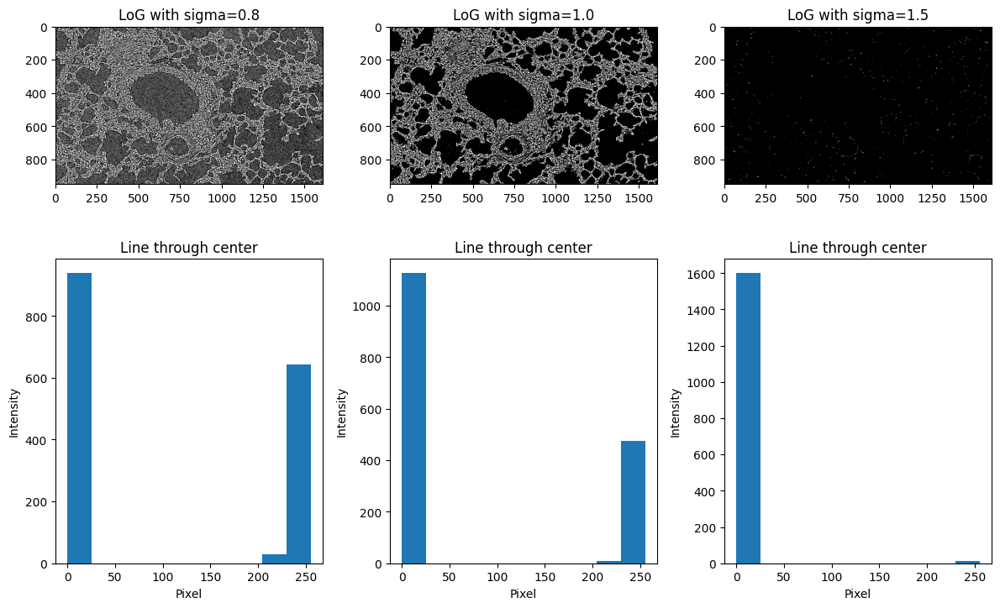

In [ ]:
def laplacian_of_gaussian(size, sigma):
    ax = np.linspace(-(size // 2), size // 2, size)
    xx, yy = np.meshgrid(ax, ax)
    norm = (xx**2 + yy**2) / (2.0 * sigma**2)
    kernel = (1.0 / (np.pi * sigma**4)) * (1.0 - norm) * np.exp(-norm)
    return -1 * kernel

sigmas = [0.8, 1.0, 1.5]

plt.figure(figsize=(12, 8))

for i, sigma in enumerate(sigmas):
    # Generate LoG kernel
    log_kernel = laplacian_of_gaussian(7, sigma)

    # Apply the LoG filter
    filtered_image = cv.filter2D(img, -1, log_kernel)
    filtered_image_uint8 =  (filtered_image * 255).astype(np.uint8)

    # Plot the filtered image
    plt.subplot(2, 3, i + 1)
    plt.imshow(filtered_image_uint8, cmap='gray')
    plt.title(f'LoG with sigma={sigma}')

    # Plot a line through the center of the image
    plt.subplot(2, 3, i + 4)
    plt.hist(filtered_image_uint8[180, :], label=f'sigma={sigma}')
    plt.title('Line through center')
    plt.xlabel('Pixel')
    plt.ylabel('Intensity')

plt.tight_layout()
plt.show()

In [ ]:
kernel_lap_s1 = laplacian_of_gaussian(7, 1)
filtered_image_loG = cv.filter2D(img, -1, kernel_lap_s1)
filtered_image_loG =  (filtered_image_loG * 255).astype(np.uint8)

# **4E** Apply the Canny edge detection algorithm (use matlab “edge(IMG, ‘canny’)” or similar in python)

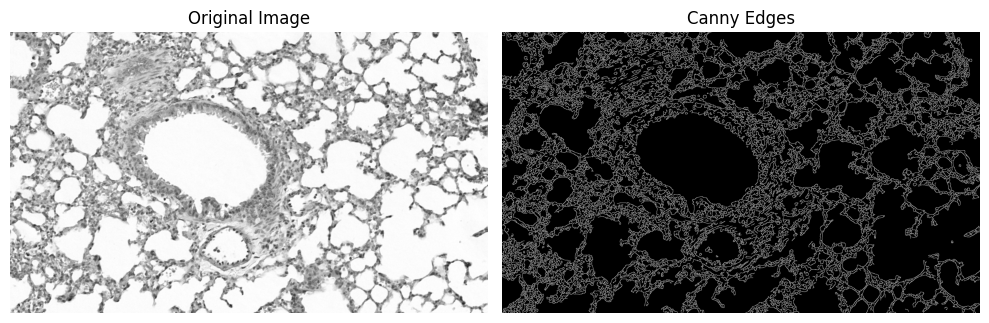

In [ ]:
canny_edges = cv.Canny(img, 100, 200)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(canny_edges, cmap='gray')
plt.title('Canny Edges')
plt.axis('off')

plt.tight_layout()
plt.show()

# **4F:** Compare the performance of the filters and in terms of their ability to detect edges in the images. Which do you think worked best on your image?



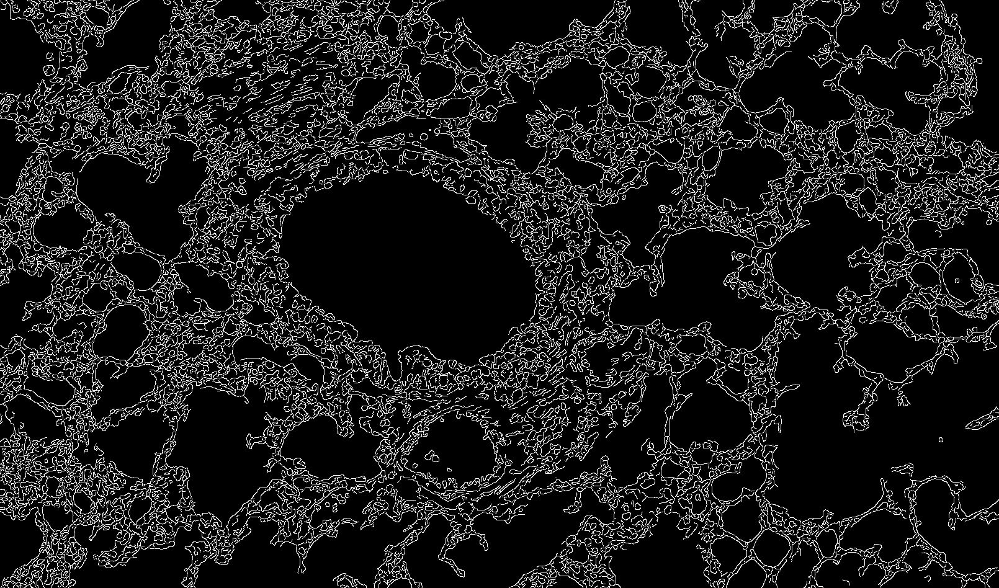

In [ ]:
cv2_imshow(canny_edges)

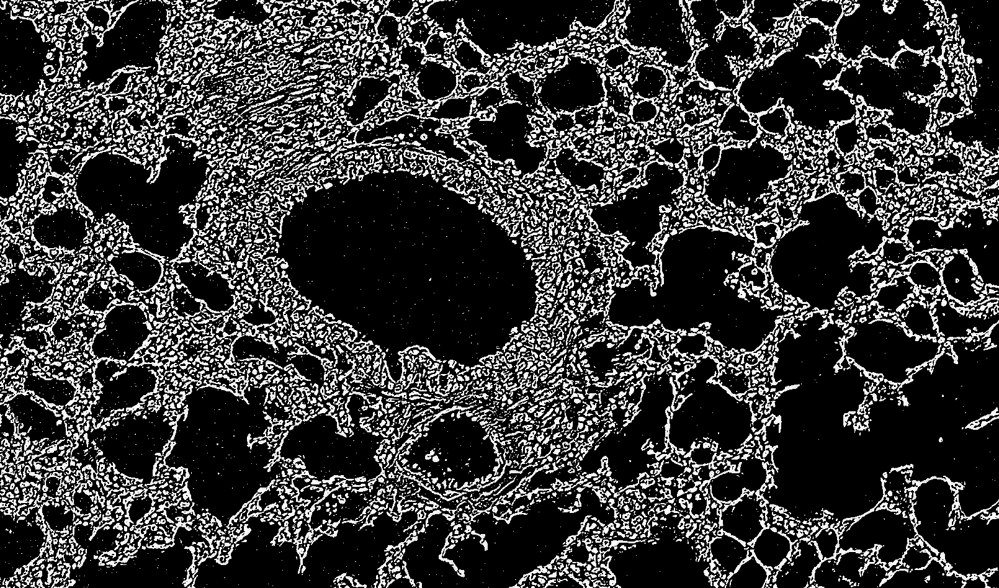

In [ ]:
cv2_imshow(filtered_image_loG)

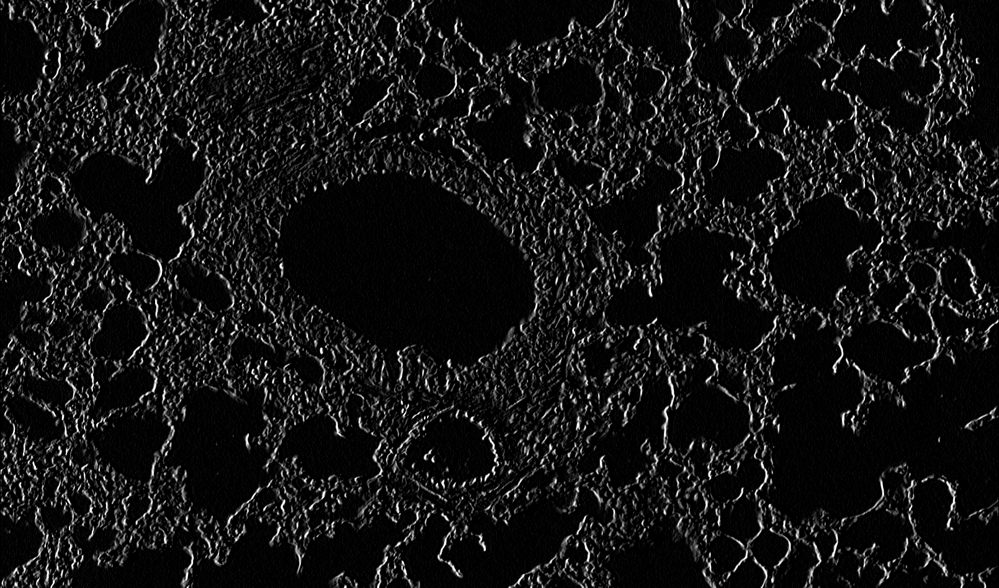

In [ ]:
cv2_imshow(sobel_x)

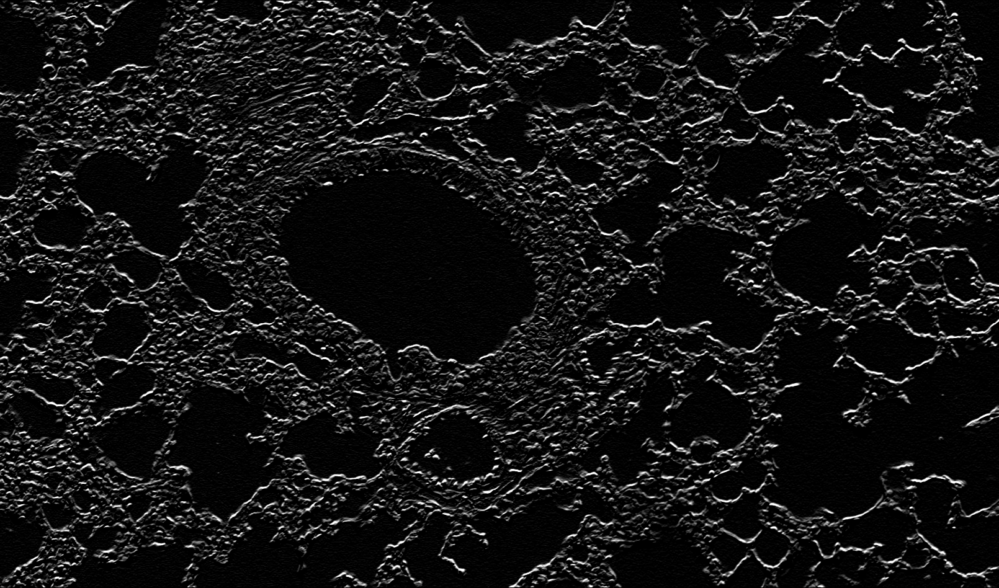

In [ ]:
cv2_imshow(sobel_y)

# **5A** Show the Frequency Domain representation of your image with: i) original greyscale values, ii) logarithmic greyscale values

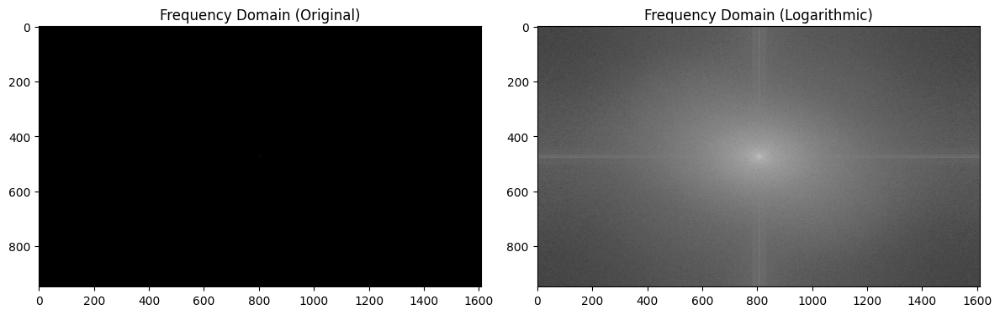

In [ ]:
f_transform = np.fft.fft2(img)
f_shift = np.fft.fftshift(f_transform)

magnitude_spectrum = np.abs(f_shift)

magnitude_spectrum_log = np.log(1 + magnitude_spectrum)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(magnitude_spectrum, cmap='gray')
plt.title('Frequency Domain (Original)')

plt.subplot(1, 2, 2)
plt.imshow(magnitude_spectrum_log, cmap='gray')
plt.title('Frequency Domain (Logarithmic)')

plt.tight_layout()
plt.show()

# **5B** Calculate frequency domain filters for a high-pass and low-pass filter

# **5C** Apply the filters to your image

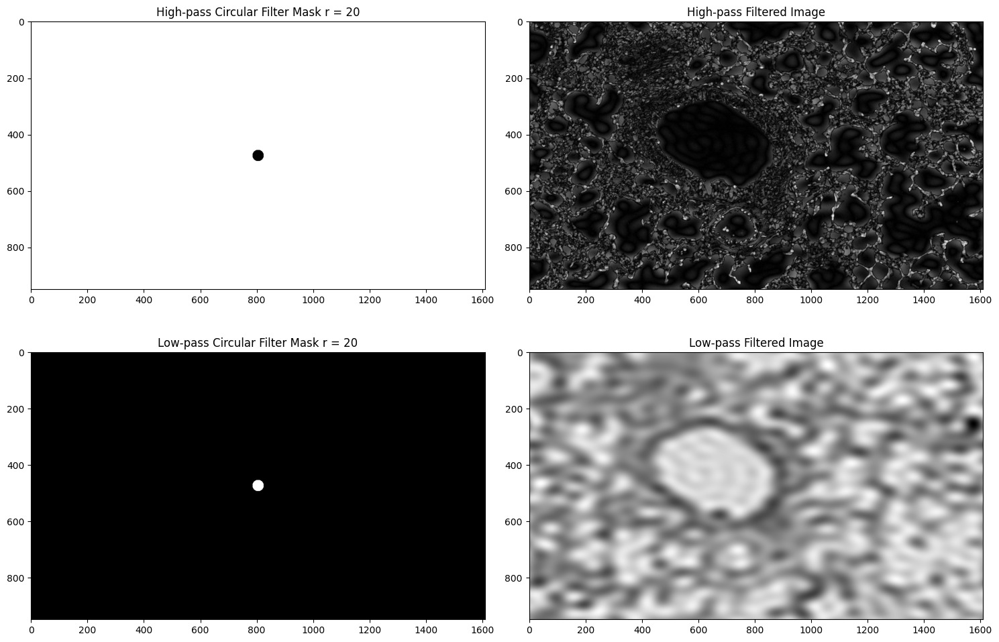

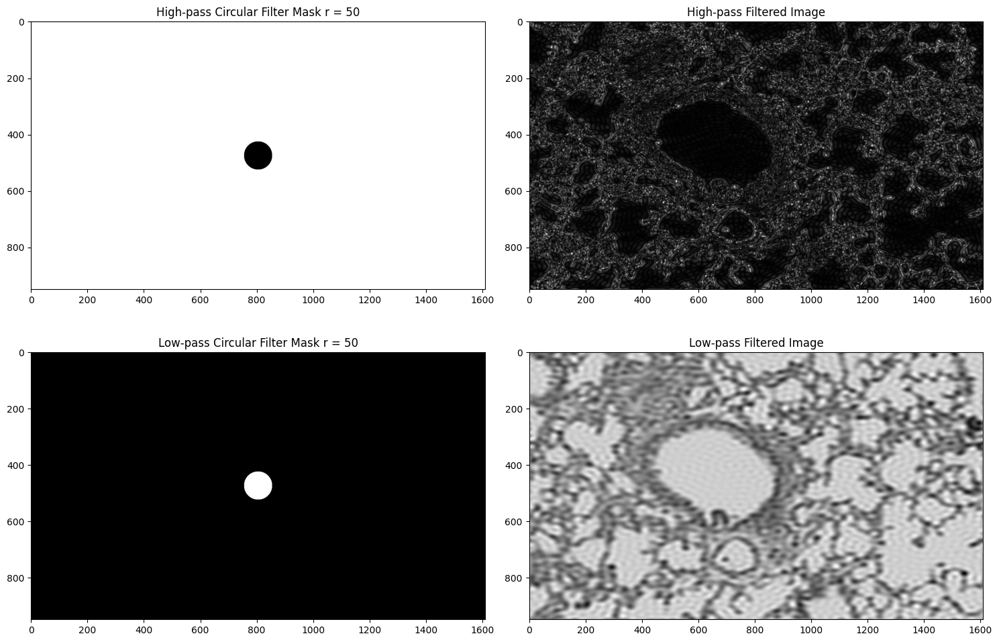

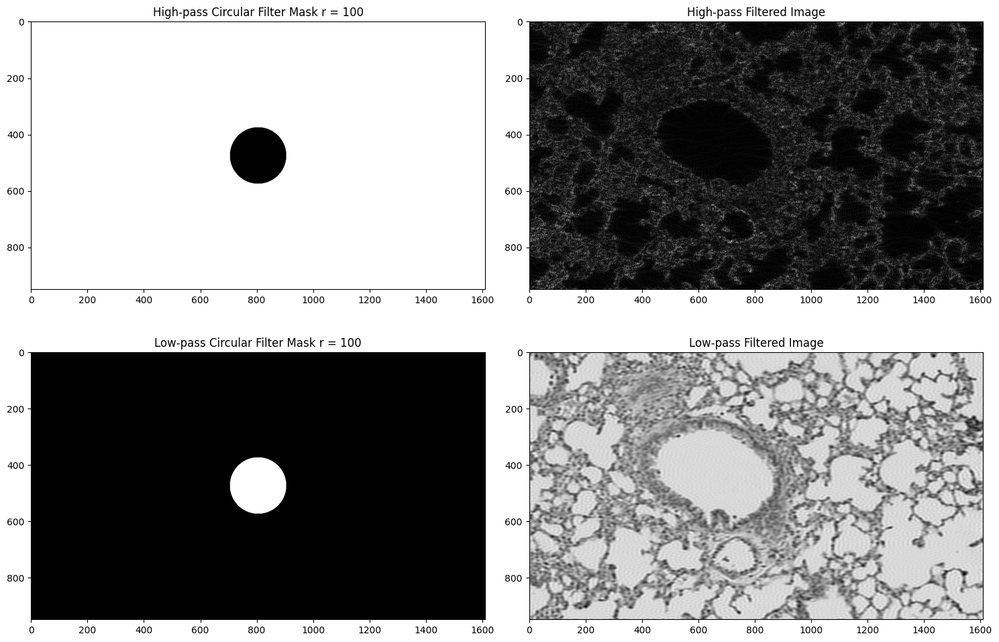

In [ ]:
# Get the image dimensions
rows, cols = img.shape
crow, ccol = rows // 2 , cols // 2  # Center of the image

x = np.arange(0, cols)
y = np.arange(0, rows)
xv, yv = np.meshgrid(x, y)

distance_from_center = np.sqrt((xv - ccol)**2 + (yv - crow)**2)

# Set 3 radius for the filters
rad = [20, 50, 100]

for r in rad:
  #High-pass Filter (HPF)
  hpf = np.ones((rows, cols), np.uint8)
  hpf[distance_from_center < r] = 0

  #Low-pass Filter (LPF)
  lpf = np.zeros((rows, cols), np.uint8)
  lpf[distance_from_center < r] = 1


  # (FFT) convertg image to frequency domain
  f = np.fft.fft2(img)
  fshift = np.fft.fftshift(f)  # Shift the zero frequency component to the center

  # High-pass Filter
  fshift_hpf = fshift * hpf
  # Inverse FFT to get the filtered image back
  f_ishift_hpf = np.fft.ifftshift(fshift_hpf)  # Inverse FFT shift
  img_hpf = np.fft.ifft2(f_ishift_hpf)
  img_hpf = np.abs(img_hpf)  # (real part)

  # Low-pass Filter
  fshift_lpf = fshift * lpf
  # Inverse FFT to get the filtered image back
  f_ishift_lpf = np.fft.ifftshift(fshift_lpf)  # Inverse FFT shift
  img_lpf = np.fft.ifft2(f_ishift_lpf)
  img_lpf = np.abs(img_lpf)  #(real part)

  # Plot the results
  plt.figure(figsize=(15, 10))

  plt.subplot(2, 2, 1)
  plt.imshow(hpf, cmap='gray')
  plt.title(f"High-pass Circular Filter Mask r = {r}")

  plt.subplot(2, 2, 2)
  plt.imshow(img_hpf, cmap='gray')
  plt.title("High-pass Filtered Image")

  plt.subplot(2, 2, 3)
  plt.imshow(lpf, cmap='gray')
  plt.title(f"Low-pass Circular Filter Mask r = {r}")

  plt.subplot(2, 2, 4)
  plt.imshow(img_lpf, cmap='gray')
  plt.title("Low-pass Filtered Image")

  plt.tight_layout()
  plt.show()


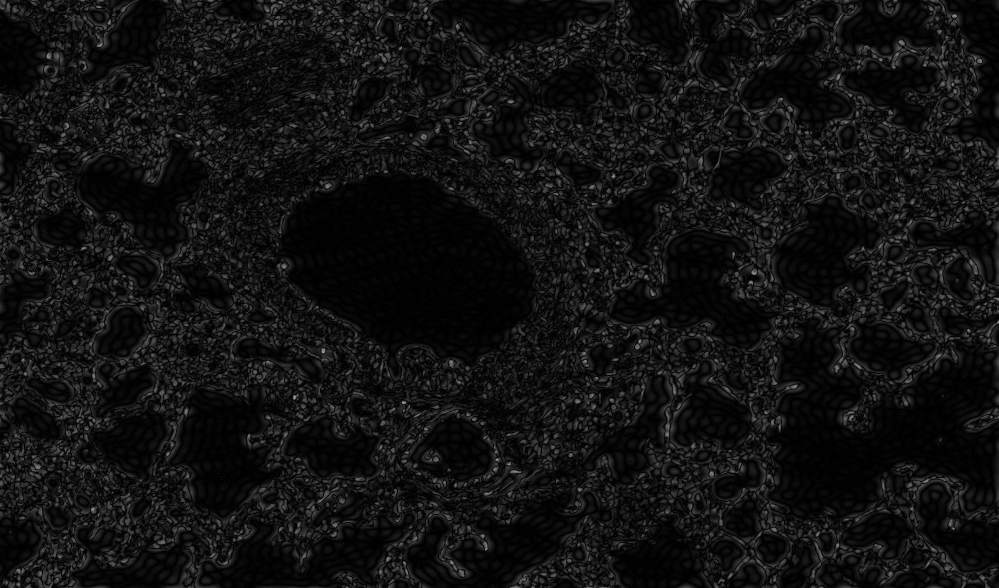

In [ ]:
cv2_imshow(img_hpf)